# Fingerprint-based similarity scores - use for dimensionality reduction plots


## Data

Here we use the **ms2structures dataset** containing 37,811 unique compounds.

In [ ]:
import os
import sys
from pathlib import Path
import pickle
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
from tqdm.notebook import tqdm

from rdkit.Chem import rdFingerprintGenerator

ROOT = Path(os.getcwd()).parents[0]
path_data = os.path.join(Path(ROOT), "data")

In [2]:
filename = "compounds_ms2structures.csv"
compounds = pd.read_csv(os.path.join(path_data, filename))
compounds.head()

,inchikey,smiles,mass,cf_class,cf_subclass,cf_superclass,formula,npc_class_results,npc_pathway_results,npc_superclass_results
0,AAAQFGUYHFJNHI,CCNC(=O)C[C@H]1C2=NN=C(N2C3=C(C=C(C=C3)OC)C(=N...,423.146204,Benzodiazepines,"1,4-benzodiazepines",Organoheterocyclic compounds,C22H22ClN5O2,NaN,Alkaloids,NaN
1,AABFWJDLCCDJJN,COC1=CC2=C(C=C1)NC3=C2C=CN=C3C4=CC=CC5=CC=CC=C54,324.126264,Harmala alkaloids,NaN,Alkaloids and derivatives,C22H16N2O,Carboline alkaloids,Alkaloids,Tryptophan alkaloids
2,AABILZKQMVKFHP,C/C=C(/C)\C(=O)O[C@H]1CC[N+]2([C@@H]1C(=CC2)CO...,427.220624,NaN,NaN,Alkaloids and derivatives,C21H33NO8,Pyrrolizidine alkaloids,Alkaloids,Ornithine alkaloids
3,AABUHSBGEIUSRJ,CC(=O)NC1=CC=C(C=C1)NC(=O)C=CC2=CC=CC=C2,280.120724,Cinnamic acids and derivatives,Cinnamic acid amides,Phenylpropanoids and polyketides,C17H16N2O2,Cinnamic acid amides,Shikimates and Phenylpropanoids,Phenylpropanoids (C6-C3)
4,AABUKWVVUWBZCS,C1=CC=C(C=C1)C2=C(C(=O)OC3=C2C=CC(=C3)O)C4=CC=...,314.094724,Neoflavonoids,Neoflavones,Phenylpropanoids and polyketides,C21H14O3,Neoflavonoids,Shikimates and Phenylpropanoids,Flavonoids


In [3]:
compounds.shape

(37811, 10)

In [4]:
compounds.value_counts("cf_superclass")

cf_superclass
Organoheterocyclic compounds                 10423
Lipids and lipid-like molecules               7496
Benzenoids                                    6608
Organic acids and derivatives                 5330
Phenylpropanoids and polyketides              3937
Organic oxygen compounds                      1599
Alkaloids and derivatives                     1003
Organic nitrogen compounds                     531
Nucleosides, nucleotides, and analogues        314
Lignans, neolignans and related compounds      233
Organosulfur compounds                         197
Organic Polymers                                35
Organohalogen compounds                         32
Organophosphorus compounds                      21
Hydrocarbon derivatives                         19
Organometallic compounds                        10
Hydrocarbons                                     9
Organic 1,3-dipolar compounds                    7
Homogeneous non-metal compounds                  6
Name: count, dtyp

In [5]:
groups = compounds.groupby('cf_superclass')['cf_class'].value_counts()
groups.loc["Organoheterocyclic compounds"].head(10)

cf_class
Indoles and derivatives       1219
Quinolines and derivatives     979
Azoles                         940
Pyridines and derivatives      682
Benzopyrans                    614
Diazanaphthalenes              521
Diazinanes                     505
Diazines                       450
Piperidines                    414
Imidazopyrimidines             343
Name: count, dtype: int64

In [6]:
low_superclass_thres = 300
low_class_thres = 500
max_superclass_size = 2000

rare_superclasses = []
keep_unchanged = []
class_to_superclass_dict = {}

superclass_counts = compounds.value_counts("cf_superclass")
for superclass, count in superclass_counts.items():
    if count < low_superclass_thres:
        rare_superclasses.append(superclass)
        for cf_class in groups.loc[superclass].index:
            class_to_superclass_dict[cf_class] = "Rare Superclass or Unknown"
    elif count > max_superclass_size:
        for cf_class, count in groups.loc[superclass].items():
            if count < low_class_thres:
                class_to_superclass_dict[cf_class] = f"{superclass}->other"
            else:
                class_to_superclass_dict[cf_class] = f"{superclass}->{cf_class}"
    else:
        keep_unchanged.append(superclass)
        for cf_class in groups.loc[superclass].index:
            class_to_superclass_dict[cf_class] = superclass

In [7]:
pd.DataFrame(class_to_superclass_dict.values())[0].unique().shape

(25,)

In [8]:
compounds_updated = compounds.copy()
compounds_updated['cf_class_superclass'] = compounds_updated['cf_class'].replace(class_to_superclass_dict)

In [9]:
compounds_updated.value_counts('cf_class_superclass')

cf_class_superclass
Benzenoids->Benzene and substituted derivatives                      5108
Organoheterocyclic compounds->other                                  4963
Organic acids and derivatives->Carboxylic acids and derivatives      4575
Lipids and lipid-like molecules->Prenol lipids                       2591
Phenylpropanoids and polyketides->other                              2125
Lipids and lipid-like molecules->Fatty Acyls                         1663
Organic oxygen compounds                                             1599
Benzenoids->other                                                    1496
Lipids and lipid-like molecules->Glycerophospholipids                1439
Lipids and lipid-like molecules->Steroids and steroid derivatives    1263
Organoheterocyclic compounds->Indoles and derivatives                1219
Phenylpropanoids and polyketides->Flavonoids                         1097
Organoheterocyclic compounds->Quinolines and derivatives              979
Alkaloids and deri

In [10]:
# Dictionary for relabeling
relabel_dict = {
    'Phenylpropanoids and polyketides': 'Phenylpropanoids, polyketides, lignans',
    'Lignans, neolignans and related compounds': 'Phenylpropanoids, polyketides, lignans',
    'Organic Polymers': 'Rare superclasses',
    'Organosulfur compounds': 'Sulfur, Phosphorus, and Halogen Compounds',
    'Organophosphorus compounds': 'Sulfur, Phosphorus, and Halogen Compounds',
    'Organohalogen compounds': 'Sulfur, Phosphorus, and Halogen Compounds',
    'Organic nitrogen compounds': 'Nitrogen compounds, nucleosides, nucleotides',
    'Nucleosides, nucleotides, and analogues': 'Nitrogen compounds, nucleosides, nucleotides',
    'Hydrocarbon derivatives': 'Rare superclasses',
    'Organometallic compounds': 'Rare superclasses',
    'Hydrocarbons': 'Rare superclasses',
    'Organic 1,3-dipolar compounds': 'Rare superclasses',
    'Homogeneous non-metal compounds': 'Rare superclasses'
}

compounds_updated['cf_superclass_reduced'] = compounds_updated['cf_superclass'].replace(relabel_dict)

In [11]:
compounds_updated.value_counts('cf_superclass_reduced')

cf_superclass_reduced
Organoheterocyclic compounds                    10423
Lipids and lipid-like molecules                  7496
Benzenoids                                       6608
Organic acids and derivatives                    5330
Phenylpropanoids, polyketides, lignans           4170
Organic oxygen compounds                         1599
Alkaloids and derivatives                        1003
Nitrogen compounds, nucleosides, nucleotides      845
Sulfur, Phosphorus, and Halogen Compounds         250
Rare superclasses                                  86
Name: count, dtype: int64

In [12]:
np.array(["=O" in s for s in compounds.smiles]).sum()

np.int64(31316)

## Compute fingerprints
Circular fingerprints --> and variants

In [ ]:
# Add source code path
sys.path.insert(0, os.path.join(ROOT, "src"))

# Import funtion/classes from source code
from fingerprint_computation import compute_fingerprints_from_smiles
from metrics import generalized_tanimoto_similarity_matrix_sparse, generalized_tanimoto_similarity_matrix
from metrics import jaccard_similarity_matrix_sparse, jaccard_similarity_matrix

# Brute-force NN computation

In [ ]:
from scipy.sparse import lil_matrix


def compute_knn(vectors, similarity_measure, weights=None, max_batch=1000, n_neighbors=100):
    n_splits = int(np.ceil(len(vectors) / max_batch))

    # Initialize a sparse matrix to store only the top n_neighbors scores
    #scores_all = lil_matrix((len(vectors), len(vectors)), dtype=np.float32)

    knn_indices = np.zeros((len(vectors), n_neighbors), dtype=np.int32)
    knn_dists= np.zeros((len(vectors), n_neighbors), dtype=np.float32)
    
    for i in tqdm(range(n_splits)):
        start_i, end_i = i * max_batch, min((i + 1) * max_batch, len(vectors))

        sub_vectors_i = vectors[start_i:end_i]

        # Compute the similarity between the sub-vectors
        if weights is not None:
            distances = 1 - similarity_measure(sub_vectors_i, vectors, weights)
        else:
            distances = 1 - similarity_measure(sub_vectors_i, vectors)
            
        # Get the indices of the nearest neighbors (including the point itself)
        knn_indices[start_i:end_i, :] = np.argsort(distances, axis=1)[:, :n_neighbors]

        # Sort the distances accordingly
        knn_dists[start_i:end_i, :] = np.sort(distances, axis=1)[:, :n_neighbors]

    return knn_indices, knn_dists


## Baseline: Tanimoto + Morgan-3 binary (4096 bit)

In [21]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3 = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=False, sparse=False, progress_bar=True
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:06<00:00, 5827.67it/s]


In [22]:
%%time

knn_indices_base, knn_dists_base = compute_knn(
    fingerprints_morgan3, jaccard_similarity_matrix, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 5min 14s, sys: 1min 19s, total: 6min 33s
Wall time: 42.2 s


In [23]:
knn_indices_base.shape

(37811, 100)

In [24]:
knn_indices_base[1]

array([    1, 10086, 12710, 31065, 34225,  3028,  2235, 30846, 12182,
       19591,  7297, 23020, 33314, 22115, 35880, 24011, 10107, 18537,
       20192, 17654, 23254, 31712, 24944, 25291, 36379,  8322, 15063,
        3915, 12936,  9734, 25592, 29873, 15490, 17114,  2356,  9679,
       16585,  9106, 12402, 15910,  3067,  8262, 35272,  3725, 28258,
       18944,  7614, 12374, 10404,  7957, 32978,  4007, 24169, 26236,
       15818, 10146, 22359,  6465, 24196, 34594, 13659, 16611, 11129,
       34516,  9555, 15229, 27161, 14609, 23661,  9624,  4091,  6007,
       21035,  9954, 16517, 17097, 20704, 14921, 37401,  4032,  5747,
       15166, 32393, 25135, 27060,  5106, 35047, 24915, 15877, 37186,
       19543, 17639, 13474, 25174, 37286, 17900,  5473,  3042, 34428,
       29928], dtype=int32)

In [45]:
path_knn = "../experiments/knn_computations/"

In [27]:
with open(os.path.join(path_knn, "knng_morgan3_binary_4096.pickle"), 'wb') as handle:
    pickle.dump([knn_indices_base, knn_dists_base], handle, protocol=pickle.HIGHEST_PROTOCOL)

## Baseline 2: Tanimoto + Morgan-3 binary (sparse)

In [59]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=False, sparse=True, progress_bar=True
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:05<00:00, 7050.82it/s]


In [60]:
%%time

knn_indices_base, knn_dists_base = compute_knn(
    fingerprints_morgan3_sparse, jaccard_similarity_matrix_sparse, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 13min 4s, sys: 10.7 s, total: 13min 14s
Wall time: 57.8 s


In [4]:
path_knn = "../experiments/knn_computations/"

In [61]:
with open(os.path.join(path_knn, "knng_morgan3_binary_sparse.pickle"), 'wb') as handle:
    pickle.dump([knn_indices_base, knn_dists_base], handle, protocol=pickle.HIGHEST_PROTOCOL)

## Comparison 1: Morgan-3 count sparse

In [31]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True, progress_bar=True
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:05<00:00, 6720.95it/s]


In [32]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_morgan3_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000
)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 11min 53s, sys: 7.15 s, total: 12min
Wall time: 1min 9s


In [33]:
with open(os.path.join(path_knn,'knng_morgan3_count_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

## Comparison 2: Morgan-3 log-count sparse

In [36]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3_log_count_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True, bit_scaling="log",
)

In [37]:
%%time

knn_indices_lc, knn_dists_lc = compute_knn(
    fingerprints_morgan3_log_count_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000
)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 11min 53s, sys: 7.52 s, total: 12min 1s
Wall time: 1min 9s


In [38]:
with open(os.path.join(path_knn, 'knng_morgan3_log_count_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices_lc, knn_dists_lc], handle, protocol=pickle.HIGHEST_PROTOCOL)

## Comparison 3: Morgan-9 count sparse

In [39]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=9, fpSize=4096)

fingerprints_morgan9_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True
)

In [40]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_morgan9_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 18min 37s, sys: 7.98 s, total: 18min 45s
Wall time: 1min 42s


In [41]:
with open(os.path.join(path_knn, 'knng_morgan9_count_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

## Comparison 4: Morgan-9 log-count sparse

In [62]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=9, fpSize=4096)

fingerprints_morgan9_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True, bit_scaling="log",
)

In [63]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_morgan9_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 18min 41s, sys: 8.62 s, total: 18min 50s
Wall time: 1min 45s


In [64]:
with open(os.path.join(path_knn, 'knng_morgan9_log_count_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

## Different fingerprints: rdkit (4096 bit & sparse)

In [65]:
fpgen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=4096)

fingerprints_rdkit = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=False,
    sparse=False,
    progress_bar=True
)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:41<00:00, 908.39it/s]


In [66]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_rdkit, jaccard_similarity_matrix, max_batch=3000)

with open(os.path.join(path_knn, 'knng_rdkit_binary.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 5min 3s, sys: 1min 20s, total: 6min 24s
Wall time: 42.1 s


In [12]:
fpgen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=4096)

fingerprints_rdkit_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=False,
    sparse=True,
    progress_bar=True
)

 48%|████████████████▋                  | 17984/37811 [00:17<00:19, 1024.67it/s]


KeyboardInterrupt: 

In [67]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_rdkit_sparse, jaccard_similarity_matrix_sparse, max_batch=3000)

with open(os.path.join(path_knn, 'knng_rdkit_binary_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 2h 55min 22s, sys: 13.2 s, total: 2h 55min 36s
Wall time: 6min 50s


## Different fingerprints: rdkit count (4096 bit & sparse)

In [12]:
fpgen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=4096)

fingerprints_rdkit_count = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=True,
    sparse=False,
    progress_bar=True
)


100%|████████████████████████████████████| 37811/37811 [00:46<00:00, 812.78it/s]


In [23]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_rdkit_count, generalized_tanimoto_similarity_matrix, max_batch=3000)

with open(os.path.join(path_knn, 'knng_rdkit_count.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

In [15]:
fpgen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=4096)

fingerprints_rdkit_count_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, 
    fpgen,
    count=True,
    sparse=True,
    progress_bar=True
)

100%|████████████████████████████████████| 37811/37811 [00:46<00:00, 814.55it/s]


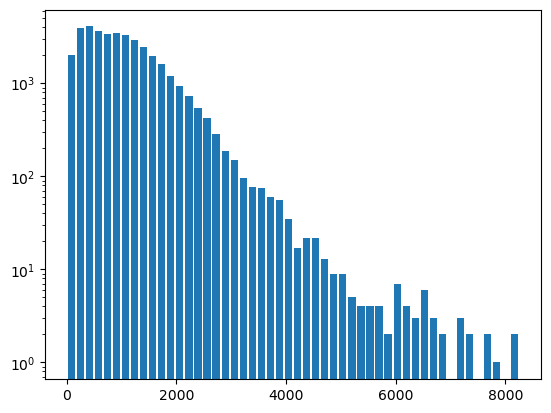

In [43]:
plt.hist(np.array([len(x[0]) for x in fingerprints_rdkit_count_sparse]), bins=50, rwidth=0.8)
plt.yscale("log")

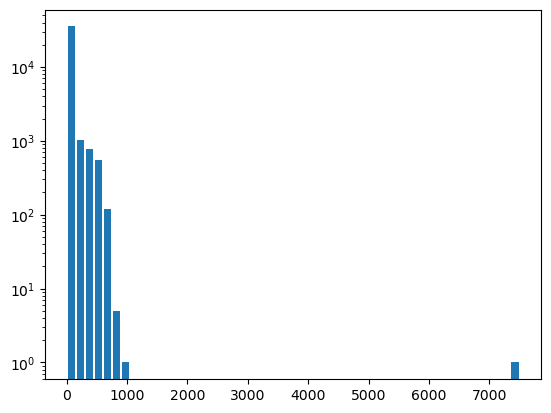

In [25]:
plt.hist(np.array([max(x[1]) for x in fingerprints_rdkit_count_sparse]), bins=50, rwidth=0.8)
plt.yscale("log")

In [27]:
max_counts = np.array([max(x[1]) for x in fingerprints_rdkit_count_sparse])
idx = np.where(max_counts > 1000)[0]

In [41]:
fingerprints_rdkit_count_sparse[idx[0]]

(array([  13793996,   35606371,   63125013,  128793864,  160065272,
         162437181,  190652694,  258830767,  289784410,  321756870,
         374073638,  375489799,  387529471,  438644839,  478749050,
         569919052,  571942521,  621897753,  622349026,  780940949,
         809881222,  993209814, 1032328097, 1071845189, 1099493707,
        1165939648, 1282827575, 1344666626, 1354076959, 1432195402,
        1493251244, 1572691845, 1646536563, 1668531109, 1731483522,
        1755692500, 1846759111, 1886254783, 1904220952, 1919088024,
        1946712616, 1949583554, 1964981884, 2002940407, 2100162841,
        2143045560, 2316115570, 2342599961, 2362629710, 2396134095,
        2404948708, 2593151579, 2659036643, 2866646448, 2960155808,
        3029529354, 3108701025, 3261006322, 3517902689, 3523227575,
        3752102730, 3764713633, 3794590403, 3943007027]),
 array([2400, 1320,   90,  720,  360, 2640, 2760,   60,   12,  180,  180,
          20, 1320,  720, 1320,  720,  300,  120,   

In [29]:
compounds.iloc[idx]

,inchikey,smiles,mass,cf_class,cf_subclass,cf_superclass,formula,npc_class_results,npc_pathway_results,npc_superclass_results
33899,XMWRBQBLMFGWIX,C12=C3C4=C5C6=C1C7=C8C9=C1C%10=C%11C(=C29)C3=C...,720.66,Phenanthrenes and derivatives,Triphenylenes,Benzenoids,C60,NaN,NaN,NaN


In [31]:
compounds.iloc[idx].smiles.values

array(['C12=C3C4=C5C6=C1C7=C8C9=C1C%10=C%11C(=C29)C3=C2C3=C4C4=C5C5=C9C6=C7C6=C7C8=C1C1=C8C%10=C%10C%11=C2C2=C3C3=C4C4=C5C5=C%11C%12=C(C6=C95)C7=C1C1=C%12C5=C%11C4=C3C3=C5C(=C81)C%10=C23'],
      dtype=object)

In [35]:
max_counts.max()

np.int32(7500)

In [38]:
7 * 3 * 60

1260

In [44]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_rdkit_count_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=1000)

with open(os.path.join(path_knn, 'knng_rdkit_count_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

  0%|          | 0/38 [00:00<?, ?it/s]

NameError: name 'path_knn' is not defined

## Different fingerprints: MAP4 (4096 bit & sparse)

In [69]:
from typing import List
from rdkit.Chem import Mol, MolFromSmiles

def compute_map_fingerprints_from_smiles(smiles, map_generator):
    
    molecules: List[Mol] = [MolFromSmiles(s) for s in smiles]
    fingerprints_map: np.ndarray = map_generator.calculate_many(
        molecules,
        number_of_threads=32,
        verbose=True,
    )
    return list(fingerprints_map)


def compute_sparse_map_fingerprints_from_smiles_serial(
        smiles,
        map_generator
        ):

    molecules: List[Mol] = [MolFromSmiles(s) for s in smiles]
    fingerprints = []
    for mol in tqdm(molecules):
        fp_bits = map_generator._calculate(mol)
        fingerprints.append(np.sort(map_generator.encoder.hash(fp_bits)))
    return fingerprints

In [70]:
from map4 import MAP4

map4gen = MAP4(
    dimensions=4096,
    radius=2,
    include_duplicated_shingles=False,
)

fingerprints_map4 = compute_map_fingerprints_from_smiles(compounds.smiles, map4gen)
fingerprints_map4_sparse = compute_sparse_map_fingerprints_from_smiles_serial(compounds.smiles, map4gen)

Calculating fingerprints:   0%|                                                                               …

  0%|          | 0/37811 [00:00<?, ?it/s]

In [71]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_map4, jaccard_similarity_matrix, max_batch=3000)

with open(os.path.join(path_knn, 'knng_map4.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 5min 4s, sys: 1min 19s, total: 6min 24s
Wall time: 42.3 s


In [72]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_map4_sparse, jaccard_similarity_matrix_sparse, max_batch=3000)

with open(os.path.join(path_knn, 'knng_map4_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 1h 56min 42s, sys: 12.4 s, total: 1h 56min 54s
Wall time: 4min 40s


## with idf bit weighing

In [42]:
bit_weighing_ms2structures = pd.read_csv("bit_weighing_ms2structures_morgan3.csv")
bit_weighing_biostructures = pd.read_csv("bit_weighing_biostructures_morgan3.csv")

In [43]:
bit_weighing_ms2structures_dict = {x.bit: x.idf_weighing for _, x in bit_weighing_ms2structures.iterrows()}
bit_weighing_biostructures_dict = {x.bit: x.idf_weighing for _, x in bit_weighing_biostructures.iterrows()}

In [44]:
bit_weighing_ms2structures_m9 = pd.read_csv("bit_weighing_ms2structures_morgan9.csv")
bit_weighing_biostructures_m9 = pd.read_csv("bit_weighing_biostructures_morgan9.csv")

In [45]:
bit_weighing_ms2structures_m9_dict = {x.bit: x.idf_weighing for _, x in bit_weighing_ms2structures_m9.iterrows()}
bit_weighing_biostructures_m9_dict = {x.bit: x.idf_weighing for _, x in bit_weighing_biostructures_m9.iterrows()}

In [60]:
bit_weighing_ms2structures_rdkit = pd.read_csv("bit_weighing_ms2structures_rdkit.csv")
bit_weighing_ms2structures_rdkit_dict = {x.bit: x.idf_weighing for _, x in bit_weighing_ms2structures_rdkit.iterrows()}

## Compute k-nns with count vectors scaled by idf values (=TF-IDF)

### Morgan-3 count + IDF (ms2structures)

In [46]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3_tfidf_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True,
    bit_weighing=bit_weighing_ms2structures_dict,
    progress_bar=True
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:06<00:00, 6114.44it/s]


In [47]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_morgan3_tfidf_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 11min 54s, sys: 7.41 s, total: 12min 2s
Wall time: 1min 9s


In [48]:
with open(os.path.join(path_knn, 'knng_morgan3_tfidf_ms2structures_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

### Morgan-3 count + IDF (biostructures)

In [56]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=3, fpSize=4096)

fingerprints_morgan3_tfidf_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True,
    bit_weighing=bit_weighing_biostructures_dict,
    progress_bar=True
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:06<00:00, 5978.11it/s]


In [57]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_morgan3_tfidf_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 11min 56s, sys: 7.35 s, total: 12min 3s
Wall time: 1min 10s


In [58]:
with open(os.path.join(path_knn, 'knng_morgan3_tfidf_biostructures_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

### Morgan-9 count + IDF (ms2structures)

In [50]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=9, fpSize=4096)

fingerprints_morgan9_tfidf_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True,
    bit_weighing=bit_weighing_ms2structures_m9_dict,
    progress_bar=True
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:09<00:00, 3922.54it/s]


In [51]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_morgan9_tfidf_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 18min 40s, sys: 8.51 s, total: 18min 48s
Wall time: 1min 45s


In [52]:
with open(os.path.join(path_knn, 'knng_morgan9_tfidf_ms2structures_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

### Morgan-9 count + IDF (biostructures)

In [53]:
fpgen = rdFingerprintGenerator.GetMorganGenerator(radius=9, fpSize=4096)

fingerprints_morgan9_tfidf_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True,
    bit_weighing=bit_weighing_biostructures_m9_dict,
    progress_bar=True
)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 37811/37811 [00:09<00:00, 3798.40it/s]


In [54]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_morgan9_tfidf_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=3000)

  0%|          | 0/13 [00:00<?, ?it/s]

CPU times: user 18min 39s, sys: 8.23 s, total: 18min 47s
Wall time: 1min 45s


In [55]:
with open(os.path.join(path_knn, 'knng_morgan9_tfidf_biostructures_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

### rdkit count + IDF (ms2structures)

In [61]:
fpgen = rdFingerprintGenerator.GetRDKitFPGenerator(fpSize=4096)

fingerprints_rdkit_tfidf_sparse = compute_fingerprints_from_smiles(
    compounds.smiles, fpgen, count=True, sparse=True,
    bit_weighing=bit_weighing_ms2structures_rdkit_dict,
    progress_bar=True
)

100%|████████████████████████████████████| 37811/37811 [01:00<00:00, 626.17it/s]


In [62]:
fingerprints_rdkit_tfidf_sparse[0]

(array([   2728909,    7648865,    7746640, ..., 4281855361, 4294389836,
        4294558796]),
 array([1.1685239 , 0.23732792, 0.73120326, ..., 0.46574745, 1.9201312 ,
        0.7725034 ], dtype=float32))

In [63]:
%%time

knn_indices, knn_dists = compute_knn(
    fingerprints_rdkit_tfidf_sparse, generalized_tanimoto_similarity_matrix_sparse, max_batch=1000)

  0%|          | 0/38 [00:00<?, ?it/s]

CPU times: user 2h 47min, sys: 46.8 s, total: 2h 47min 47s
Wall time: 17min 25s


In [64]:
with open(os.path.join(path_knn, 'knng_rdkit_tfidf_ms2structures_sparse.pickle'), 'wb') as handle:
    pickle.dump([knn_indices, knn_dists], handle, protocol=pickle.HIGHEST_PROTOCOL)

## Generate Umap

In [48]:
import umap

In [65]:
experiments = [
    "morgan3_binary_4096",
    "morgan3_binary_sparse",
    "morgan3_count_sparse",
    "morgan9_count_sparse",
    "morgan3_log_count_sparse",
    "morgan9_log_count_sparse",
    "morgan3_tfidf_ms2structures_sparse",
    "morgan3_tfidf_biostructures_sparse",
    "morgan9_tfidf_ms2structures_sparse",
    "morgan9_tfidf_biostructures_sparse",
    "rdkit_binary",
    "rdkit_binary_sparse",
    "rdkit_count",
    "rdkit_count_sparse",
    "rdkit_tfidf_ms2structures_sparse",
    "map4",
    "map4_sparse",
]

In [75]:
%%time

n_neighbors = 10
min_dist = 0.25
num_points = 37811

umaps = pd.DataFrame()

for exp in experiments:
    print(exp)
    with open(os.path.join(path_knn, f"knng_{exp}.pickle"), "rb") as handle:
        (knn_indices, knn_dists) = pickle.load(handle)

    reducer = umap.UMAP(
        n_components=2,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        precomputed_knn=(knn_indices, knn_dists),
        random_state=0,
        verbose=0,
    )
    X_umap = reducer.fit_transform(np.ones((num_points, 2)))
    umaps[f"umap_1_{exp}"] = X_umap[:, 0]
    umaps[f"umap_2_{exp}"] = X_umap[:, 1]

tanimoto_morgan3_4096


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_morgan3_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_log_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_log_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_tfidf_ms2structures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_tfidf_biostructures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_tfidf_ms2structures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_tfidf_biostructures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_rdkit


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_rdkit_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_map4


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_map4_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


CPU times: user 10min 48s, sys: 388 ms, total: 10min 48s
Wall time: 2min 1s


In [71]:
umaps.head()

,umap_1_morgan3_binary_4096,umap_2_morgan3_binary_4096,umap_1_morgan3_binary_sparse,umap_2_morgan3_binary_sparse,umap_1_morgan3_count_sparse,umap_2_morgan3_count_sparse,umap_1_morgan9_count_sparse,umap_2_morgan9_count_sparse,umap_1_morgan3_log_count_sparse,umap_2_morgan3_log_count_sparse,...,umap_1_rdkit_count,umap_2_rdkit_count,umap_1_rdkit_count_sparse,umap_2_rdkit_count_sparse,umap_1_map4,umap_2_map4,umap_1_map4_sparse,umap_2_map4_sparse,umap_1_rdkit_tfidf_ms2structures_sparse,umap_2_rdkit_tfidf_ms2structures_sparse
0,10.731222,5.134701,11.415851,4.980711,-2.850390,3.979087,-2.096819,-0.907571,-3.351755,3.943121,...,-2.578807,-0.479879,-3.597458,-0.559903,9.480687,3.196093,-0.321887,4.053378,1.027230,-4.120849
1,11.613246,4.966072,8.740837,4.132095,-1.532074,4.744094,-1.808711,-0.589057,-3.996150,3.115071,...,-3.514611,-4.145359,-1.925712,-4.795182,7.113724,3.048442,-3.536052,3.423304,-3.135773,-3.970456
2,12.009865,11.385876,12.608480,11.071245,0.552141,9.813396,2.129487,3.443780,0.665863,-1.860715,...,2.756509,5.218531,2.351904,4.819392,11.354033,4.054707,1.911465,9.142961,2.129933,3.124468
3,10.865856,7.774141,11.583037,7.678115,-0.858877,4.215053,-0.445110,-0.600386,-1.836647,2.260085,...,1.142354,-2.199409,-1.576720,-0.675942,6.160431,3.405582,-1.492756,5.258271,-0.495915,-0.251021
4,13.069160,7.102161,13.392241,6.657960,-1.280348,4.082446,-1.025677,-1.031620,-3.131631,1.507093,...,-6.610639,-0.251840,-7.283176,-2.833628,5.587902,0.054376,-5.145942,2.764038,-8.119318,0.171674


In [77]:
umaps.to_csv(os.path.join(path_knn, "umap_results_nn10_md0_25.csv"), index=False)

In [49]:
%%time

n_neighbors = 100
min_dist = 0.25
num_points = 37811

umaps = pd.DataFrame()

for exp in experiments:
    print(exp)
    with open(os.path.join(path_knn, f"knng_{exp}.pickle"), "rb") as handle:
        (knn_indices, knn_dists) = pickle.load(handle)

    reducer = umap.UMAP(
        n_components=2,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        precomputed_knn=(knn_indices, knn_dists),
        random_state=0,
        verbose=0,
    )
    X_umap = reducer.fit_transform(np.ones((num_points, 2)))
    umaps[f"umap_1_{exp}"] = X_umap[:, 0]
    umaps[f"umap_2_{exp}"] = X_umap[:, 1]

morgan3_binary_4096


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan3_binary_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan3_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan9_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan3_log_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan9_log_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan3_tfidf_ms2structures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan3_tfidf_biostructures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan9_tfidf_ms2structures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


morgan9_tfidf_biostructures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


rdkit_binary


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


rdkit_binary_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


rdkit_count


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


rdkit_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


map4


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


map4_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


CPU times: user 15min 19s, sys: 1.68 s, total: 15min 20s
Wall time: 4min 57s


In [72]:
umaps.head()

,umap_1_morgan3_binary_4096,umap_2_morgan3_binary_4096,umap_1_morgan3_binary_sparse,umap_2_morgan3_binary_sparse,umap_1_morgan3_count_sparse,umap_2_morgan3_count_sparse,umap_1_morgan9_count_sparse,umap_2_morgan9_count_sparse,umap_1_morgan3_log_count_sparse,umap_2_morgan3_log_count_sparse,...,umap_1_rdkit_count,umap_2_rdkit_count,umap_1_rdkit_count_sparse,umap_2_rdkit_count_sparse,umap_1_map4,umap_2_map4,umap_1_map4_sparse,umap_2_map4_sparse,umap_1_rdkit_tfidf_ms2structures_sparse,umap_2_rdkit_tfidf_ms2structures_sparse
0,10.731222,5.134701,11.415851,4.980711,-2.850390,3.979087,-2.096819,-0.907571,-3.351755,3.943121,...,-2.578807,-0.479879,-3.597458,-0.559903,9.480687,3.196093,-0.321887,4.053378,1.027230,-4.120849
1,11.613246,4.966072,8.740837,4.132095,-1.532074,4.744094,-1.808711,-0.589057,-3.996150,3.115071,...,-3.514611,-4.145359,-1.925712,-4.795182,7.113724,3.048442,-3.536052,3.423304,-3.135773,-3.970456
2,12.009865,11.385876,12.608480,11.071245,0.552141,9.813396,2.129487,3.443780,0.665863,-1.860715,...,2.756509,5.218531,2.351904,4.819392,11.354033,4.054707,1.911465,9.142961,2.129933,3.124468
3,10.865856,7.774141,11.583037,7.678115,-0.858877,4.215053,-0.445110,-0.600386,-1.836647,2.260085,...,1.142354,-2.199409,-1.576720,-0.675942,6.160431,3.405582,-1.492756,5.258271,-0.495915,-0.251021
4,13.069160,7.102161,13.392241,6.657960,-1.280348,4.082446,-1.025677,-1.031620,-3.131631,1.507093,...,-6.610639,-0.251840,-7.283176,-2.833628,5.587902,0.054376,-5.145942,2.764038,-8.119318,0.171674


In [74]:
n_neighbors

100

In [73]:
umaps.to_csv(os.path.join(path_knn, "umap_results_nn100_md0_25.csv"), index=False)

In [58]:
import seaborn

def overview_plot(
    experiments,
    umaps,
    compounds,
    hue_label="cf_superclass",
    palette=None,
    title_addition="",
    dpi=300
):


    cmap = plt.cm.viridis
    norm = plt.Normalize(vmin=100, vmax=1000)
    colors = cmap(norm(compounds.mass))
    
    # Adjust alpha for scatter plot without affecting colorbar
    colors[:, -1] = 0.75  # Set alpha to 0.5 for all points
        
    fig, axes = plt.subplots(
        len(experiments), 2,
        figsize=(25, 12 * len(experiments)),
        dpi=dpi
    )
    
    for i, exp in enumerate(experiments):

        if i == 0:
            legend = True
        else:
            legend = False
        seaborn.scatterplot(x=umaps[f"umap_1_{exp}"].values,
                            y=umaps[f"umap_2_{exp}"].values,
                            hue=hue_label,
                            s=2,
                            #style="event",
                            data=compounds.fillna("Rare Superclass or Unknown"),
                            palette=palette,
                            ax=axes[i, 0],
                            legend=legend,
                            linewidth=0
                           )
        axes[i, 0].set_title(exp.replace("_", " ") + title_addition)
        #axes[i, 0].set_aspect('equal', adjustable='box')
        axes[i, 0].grid(True)
                    
        scatter = axes[i, 1].scatter(
            umaps[f"umap_1_{exp}"],
            umaps[f"umap_2_{exp}"], 
            s=2, 
            c=colors,
            linewidth=0
        )
        axes[i, 1].set_title(exp.replace("_", " ") + title_addition)
        #axes[i, 1].set_aspect('equal', adjustable='box')
        axes[i, 1].grid(True)

In [53]:
# try palette

palette = {
    # Alkaloids
    'Alkaloids and derivatives':             'saddlebrown',

    # Benzenoids (blues)
    'Benzenoids->Benzene and substituted derivatives': 'chocolate',
    'Benzenoids->other':                     'sandybrown',

    # Lipids and lipid-like molecules (greens)
    'Lipids and lipid-like molecules->Fatty Acyls':       'seagreen',
    'Lipids and lipid-like molecules->Glycerophospholipids': 'mediumseagreen',
    'Lipids and lipid-like molecules->Prenol lipids':     'limegreen',
    'Lipids and lipid-like molecules->Steroids and steroid derivatives': 'darkgreen',
    'Lipids and lipid-like molecules->other':             'palegreen',

    # Nucleosides etc.
    'Nucleosides, nucleotides, and analogues': 'deeppink',

    # Organic acids (oranges)
    'Organic acids and derivatives->Carboxylic acids and derivatives': 'goldenrod',
    'Organic acids and derivatives->other':     'darkorange',

    # Other organics
    'Organic nitrogen compounds':   'crimson',
    'Organic oxygen compounds':     'coral',

    # Organoheterocyclic compounds (purples)
    'Organoheterocyclic compounds->Azoles': "darkblue",
    'Organoheterocyclic compounds->Benzopyrans': "royalblue",
    'Organoheterocyclic compounds->Diazanaphthalenes': "steelblue",
    'Organoheterocyclic compounds->Diazinanes': "deepskyblue",
    'Organoheterocyclic compounds->Indoles and derivatives': "cadetblue",
    'Organoheterocyclic compounds->Pyridines and derivatives': "darkturquoise",
    'Organoheterocyclic compounds->Quinolines and derivatives': "turquoise",
    'Organoheterocyclic compounds->other': "teal",

    # Phenylpropanoids & polyketides (browns)
    'Phenylpropanoids and polyketides->Coumarins and derivatives': 'red',
    'Phenylpropanoids and polyketides->Flavonoids':               "firebrick",
    'Phenylpropanoids and polyketides->other':                    "lightcoral",

    # Everything else
    'Rare Superclass or Unknown':   'grey',
    #'unknown': "white",
}


In [54]:
experiments

['morgan3_binary_4096',
 'morgan3_binary_sparse',
 'morgan3_count_sparse',
 'morgan9_count_sparse',
 'morgan3_log_count_sparse',
 'morgan9_log_count_sparse',
 'morgan3_tfidf_ms2structures_sparse',
 'morgan3_tfidf_biostructures_sparse',
 'morgan9_tfidf_ms2structures_sparse',
 'morgan9_tfidf_biostructures_sparse',
 'rdkit_binary',
 'rdkit_binary_sparse',
 'rdkit_count',
 'rdkit_count_sparse',
 'map4',
 'map4_sparse']

In [55]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns

def plot_overview_horizontal(
    experiments,
    umaps,
    compounds,
    hue_label="cf_superclass",
    palette=None,
    title_addition="",
    dpi=300
):
    # prepare mass‐based colors
    cmap = plt.cm.viridis
    norm = plt.Normalize(vmin=100, vmax=1000)
    colors = cmap(norm(compounds.mass))
    colors[:, -1] = 0.5  # uniform alpha

    n_exp = len(experiments)
    fig = plt.figure(figsize=(n_exp * 8, 18), dpi=dpi)
    gs = gridspec.GridSpec(
        nrows=3, ncols=n_exp,
        height_ratios=[1, 1, 0.2],
        hspace=0.3, wspace=0.3
    )

    # collect axes for the mass plots
    mass_axes = []
    legend_handles = None
    legend_labels = None

    for j, exp in enumerate(experiments):
        # ─── Top row: mass‐colored scatter ───────────────────────────────
        ax_mass = fig.add_subplot(gs[0, j])
        ax_mass.scatter(
            umaps[f"umap_1_{exp}"],
            umaps[f"umap_2_{exp}"],
            s=2,
            c=colors,
            linewidth=0
        )
        ax_mass.set_title(exp.replace("_", " ") + title_addition)
        ax_mass.grid(True)
        mass_axes.append(ax_mass)

        # ─── Middle row: seaborn scatter with hue ────────────────────────
        ax_hue = fig.add_subplot(gs[1, j])
        legend_arg = 'brief' if j == 0 else False
        sns.scatterplot(
            x=umaps[f"umap_1_{exp}"],
            y=umaps[f"umap_2_{exp}"],
            hue=hue_label,
            s=2,
            data=compounds.fillna("Rare Superclass or Unknown"),
            palette=palette,
            ax=ax_hue,
            legend=legend_arg,
            linewidth=0,
        )
        ax_hue.set_title(exp.replace("_", " ") + title_addition)
        ax_hue.grid(True)

        if j == 0:
            # capture & remove in‐panel legend
            legend_handles, legend_labels = ax_hue.get_legend_handles_labels()
            ax_hue.get_legend().remove()

    # ─── Bottom row: split into legend + colorbar ─────────────────────
    # Legend on all but the last column
    legend_ax = fig.add_subplot(gs[2, :-1])
    legend_ax.axis("off")
    legend = legend_ax.legend(
        legend_handles,
        legend_labels,
        ncol=2,
        loc="upper center",
        markerscale=6,
        frameon=False
    )

    # Colorbar in the last column of bottom row
    cbar_ax = fig.add_subplot(gs[2, -1])
    cbar = fig.colorbar(
        plt.cm.ScalarMappable(norm=norm, cmap=cmap),
        cax=cbar_ax,
        orientation='horizontal',
    )
    cbar.set_label('mass')
    cbar_ax.yaxis.set_ticks_position('right')
    cbar_ax.yaxis.set_label_position('right')

    return fig


In [5]:
umaps = pd.read_csv(os.path.join(path_knn, "umap_results_nn100_md0_25.csv"))

/tmp/ipykernel_23289/3630216103.py:16: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


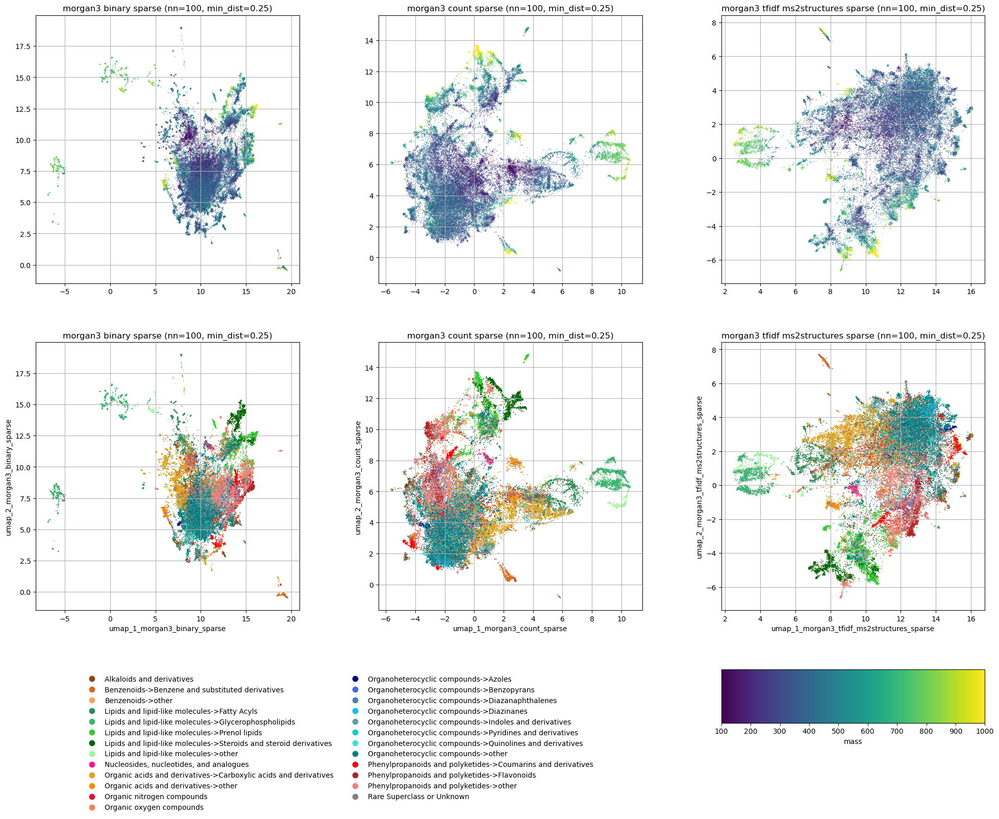

In [77]:
idx = compounds_updated.sort_values("cf_class_superclass").index
experiment_select = [
    'morgan3_binary_sparse',
    'morgan3_count_sparse',
    'morgan3_tfidf_ms2structures_sparse',
]

fig = plot_overview_horizontal(
    experiment_select, umaps.loc[np.array(list(idx))],
    compounds_updated.loc[np.array(list(idx))],
    "cf_class_superclass",
    palette=palette, #None, #"tab20",
    title_addition=" (nn=100, min_dist=0.25)",
    dpi=100
)
plt.tight_layout()
plt.savefig("umap_comparison_morgan3.png", dpi=300)
plt.savefig("umap_comparison_morgan3.eps", dpi=300)

/tmp/ipykernel_23289/2097740659.py:16: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


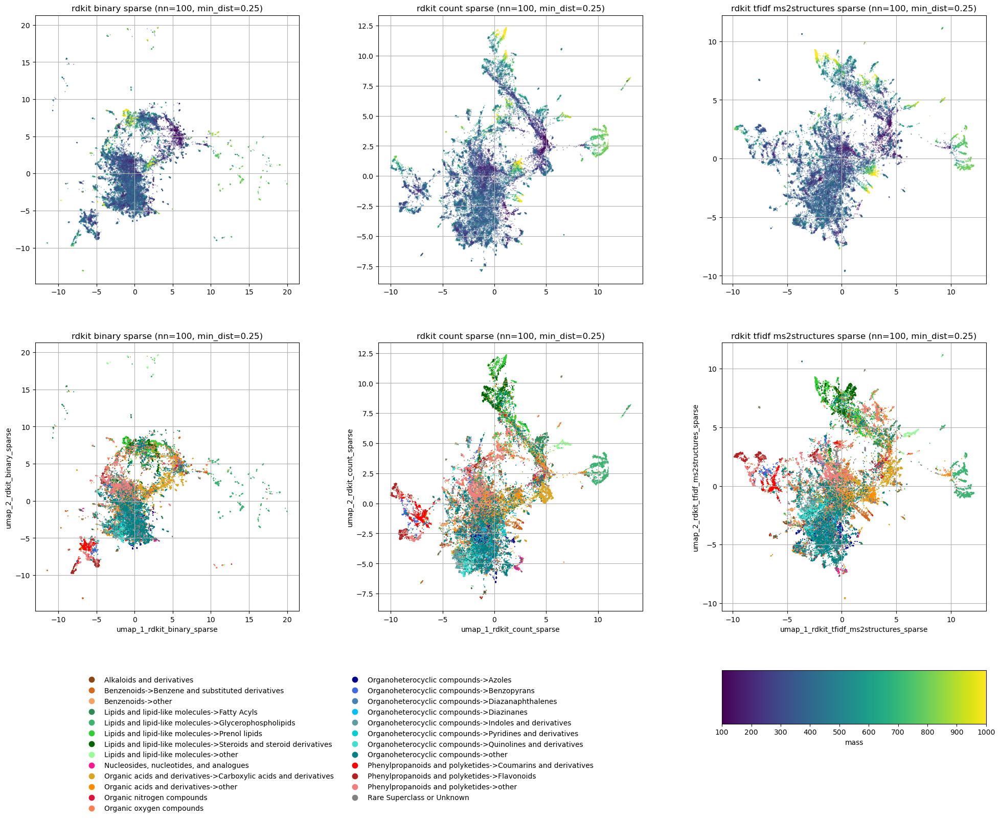

In [76]:
idx = compounds_updated.sort_values("cf_class_superclass").index
experiment_select = [
    'rdkit_binary_sparse',
    'rdkit_count_sparse',
    'rdkit_tfidf_ms2structures_sparse',
]

fig = plot_overview_horizontal(
    experiment_select, umaps.loc[np.array(list(idx))],
    compounds_updated.loc[np.array(list(idx))],
    "cf_class_superclass",
    palette=palette, #None, #"tab20",
    title_addition=" (nn=100, min_dist=0.25)",
    dpi=100
)
plt.tight_layout()
plt.savefig("umap_comparison_rdkit.png", dpi=300)
plt.savefig("umap_comparison_rdkit.eps", dpi=300)

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


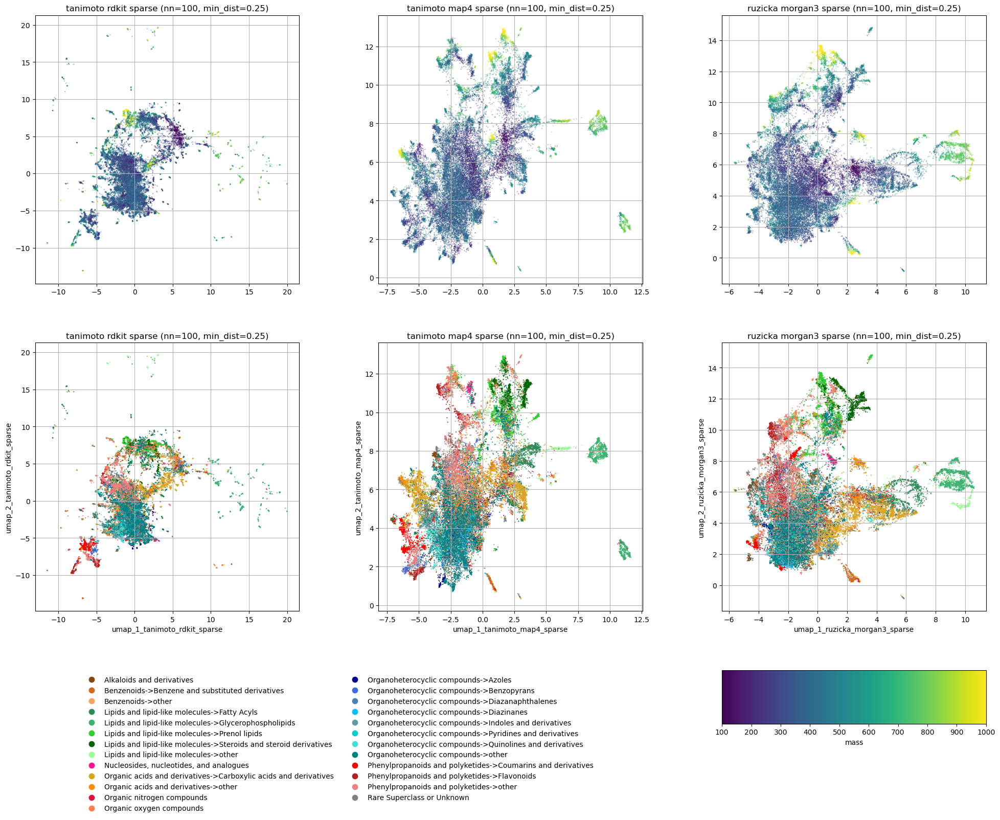

In [27]:
idx = compounds_updated.sort_values("cf_class_superclass").index
experiment_select = [
    'tanimoto_rdkit_sparse',
    'tanimoto_map4_sparse',
    'ruzicka_morgan3_sparse',
    #'ruzicka_morgan3_log_count_sparse',
    #'ruzicka_morgan3_tfidf_biostructures_sparse',
]

fig = plot_overview_horizontal(
    experiment_select, umaps.loc[np.array(list(idx))],
    compounds_updated.loc[np.array(list(idx))],
    "cf_class_superclass",
    palette=palette, #None, #"tab20",
    title_addition=" (nn=100, min_dist=0.25)",
    dpi=100
)
plt.tight_layout()
plt.savefig("umap_comparison_morgan_rdkit_map4.png", dpi=300)
plt.savefig("umap_comparison_morgan_rdkit_map4.eps", dpi=300)

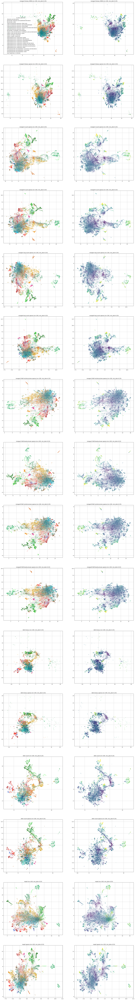

In [59]:
idx = compounds_updated.sort_values("cf_class_superclass").index

overview_plot(
    experiments,
    umaps.loc[np.array(list(idx))],
    compounds_updated.loc[np.array(list(idx))],
    "cf_class_superclass",
    palette=palette, #None, #"tab20",
    title_addition=" (nn=100, min_dist=0.25)",
    dpi=100
)

In [338]:
%%time

n_neighbors = 100
min_dist = 1.0
num_points = 37811

umaps = pd.DataFrame()

for exp in experiments:
    print(exp)
    with open(os.path.join(path_knn, f"knng_{exp}.pickle"), "rb") as handle:
        (knn_indices, knn_dists) = pickle.load(handle)

    reducer = umap.UMAP(
        n_components=2,
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        precomputed_knn=(knn_indices, knn_dists),
        random_state=0,
        verbose=0,
    )
    X_umap = reducer.fit_transform(np.ones((num_points, 2)))
    umaps[f"umap_1_{exp}"] = X_umap[:, 0]
    umaps[f"umap_2_{exp}"] = X_umap[:, 1]

tanimoto_morgan3_4096


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_morgan3_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_log_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_log_count_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_tfidf_ms2structures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan3_tfidf_biostructures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_tfidf_ms2structures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


ruzicka_morgan9_tfidf_biostructures_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_rdkit


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_rdkit_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_map4


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


tanimoto_map4_sparse


/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/home/daisy/anaconda3/envs/rdkit/lib/python3.12/site-packages/umap/umap_.py:2021: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


CPU times: user 14min 3s, sys: 490 ms, total: 14min 4s
Wall time: 4min 30s


In [339]:
umaps.to_csv(os.path.join(path_knn, "umap_results_nn100_md1.csv"), index=False)

In [379]:
umaps = pd.read_csv(os.path.join(path_knn, "umap_results_nn100_md1.csv"))

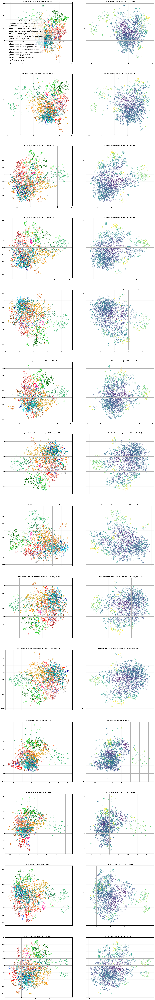

In [380]:
idx = compounds_updated.sort_values("cf_class_superclass").index

overview_plot(
    experiments, umaps.loc[np.array(list(idx))],
    compounds_updated.loc[np.array(list(idx))],
    "cf_class_superclass",
    palette=palette, #None, #"tab20",
    title_addition=" (nn=100, min_dist=1.0)",
    dpi=100
)

# Density plots

In [381]:
from scipy.stats import gaussian_kde
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as mpatches


def compute_grid_and_density(x, y, bw_method):
    # Create a 2D density function using gaussian_kde
    kde = gaussian_kde([x, y], bw_method=bw_method)
    boundary = np.abs(x.min() - x.max())/20
    xmin, xmax = x.min() - boundary, x.max() + boundary
    ymin, ymax = y.min() - boundary, y.max() + boundary
    
    # Create a meshgrid for the plot
    xx, yy = np.mgrid[xmin:xmax:100j, ymin:ymax:100j]
    positions = np.vstack([xx.ravel(), yy.ravel()])
    density = kde(positions).reshape(xx.shape)
    return xx, yy, density


def density_plot(x, y, mask_colormap_list, ax, title, bw_method=0.2, alpha=0.6):
    """
    mask_colormap_list: List of tuples in the form (mask, colormap)
    """
    x_min = x.min()
    x_max = x.max()
    y_min = y.min()
    y_max = y.max()

    legends = []
    #legend_names = []
    # define handles and labels that will get added to legend
    handles, labels = plt.gca().get_legend_handles_labels()

    for name, mask, colormap_name in mask_colormap_list:
        x_masked = x[mask]
        y_masked = y[mask]
        xx, yy, density = compute_grid_and_density(x_masked, y_masked, bw_method)

        cmap = plt.get_cmap(colormap_name, 256)

        # Define density levels
        levels = np.linspace(np.min(density), np.max(density), 20)

        # Mask the lowest density values to avoid filling empty space with transparent white
        density = np.ma.masked_where(density < levels[1]/2, density)
        
        # Filled contour plot
        contourf = ax.contourf(xx, yy, density, levels=levels, cmap=cmap, alpha=alpha)

        # Contour lines (optional, uncomment if needed)
        ax.contour(xx, yy, density, levels=levels, colors=[cmap(1.0)], linewidths=0.5) #colors="k", linestyles="dotted")

        #h1, _ = contourf.legend_elements()
        #legends.append(h1)
        #legend_names.append(name)
        patch = mpatches.Patch(color=cmap(0.7), label=name)
        legends.append(patch)

        # Optionally, you could add a colorbar for each plot if needed:
        # cbar = fig.colorbar(contourf, ax=ax)
        # cbar.ax.set_ylabel('density')
        # cbar.add_lines(contour)

    # Add labels and title
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')
    ax.set_title(title)

    # Set limits
    ax.set_xlim(x_min, x_max)
    ax.set_ylim(y_min, y_max)
    ax.grid(True)
    #ax.legend([h[0] for h in legends], [name for name in legend_names])
    #add handles
    handles.extend(legends)
    
    #add legend
    ax.legend(handles=handles)
    return 

In [385]:
compounds_updated.cf_superclass.fillna("unknown").value_counts()

cf_superclass
Organoheterocyclic compounds                 10423
Lipids and lipid-like molecules               7496
Benzenoids                                    6608
Organic acids and derivatives                 5330
Phenylpropanoids and polyketides              3937
Organic oxygen compounds                      1599
Alkaloids and derivatives                     1003
Organic nitrogen compounds                     531
Nucleosides, nucleotides, and analogues        314
Lignans, neolignans and related compounds      233
Organosulfur compounds                         197
Organic Polymers                                35
Organohalogen compounds                         32
Organophosphorus compounds                      21
Hydrocarbon derivatives                         19
Organometallic compounds                        10
Hydrocarbons                                     9
Organic 1,3-dipolar compounds                    7
Homogeneous non-metal compounds                  6
unknown          

In [387]:
is_lipid = np.array([x.startswith("Lipids") for x in compounds_updated.fillna("unknown").cf_superclass])
is_organoheterocyclic = np.array([x.startswith("Organoheterocyclic") for x in compounds_updated.fillna("unknown").cf_superclass])
is_acids = np.array([x.startswith("Organic acids") for x in compounds_updated.fillna("unknown").cf_superclass])

#is_benzenoid = np.array([x.startswith("Benzenoid") for x in compounds_updated.cf_superclass])

In [389]:
umaps.columns

Index(['umap_1_tanimoto_morgan3_4096', 'umap_2_tanimoto_morgan3_4096',
       'umap_1_tanimoto_morgan3_sparse', 'umap_2_tanimoto_morgan3_sparse',
       'umap_1_ruzicka_morgan3_sparse', 'umap_2_ruzicka_morgan3_sparse',
       'umap_1_ruzicka_morgan9_sparse', 'umap_2_ruzicka_morgan9_sparse',
       'umap_1_ruzicka_morgan3_log_count_sparse',
       'umap_2_ruzicka_morgan3_log_count_sparse',
       'umap_1_ruzicka_morgan9_log_count_sparse',
       'umap_2_ruzicka_morgan9_log_count_sparse',
       'umap_1_ruzicka_morgan3_tfidf_ms2structures_sparse',
       'umap_2_ruzicka_morgan3_tfidf_ms2structures_sparse',
       'umap_1_ruzicka_morgan3_tfidf_biostructures_sparse',
       'umap_2_ruzicka_morgan3_tfidf_biostructures_sparse',
       'umap_1_ruzicka_morgan9_tfidf_ms2structures_sparse',
       'umap_2_ruzicka_morgan9_tfidf_ms2structures_sparse',
       'umap_1_ruzicka_morgan9_tfidf_biostructures_sparse',
       'umap_2_ruzicka_morgan9_tfidf_biostructures_sparse',
       'umap_1_tanimoto_rdki

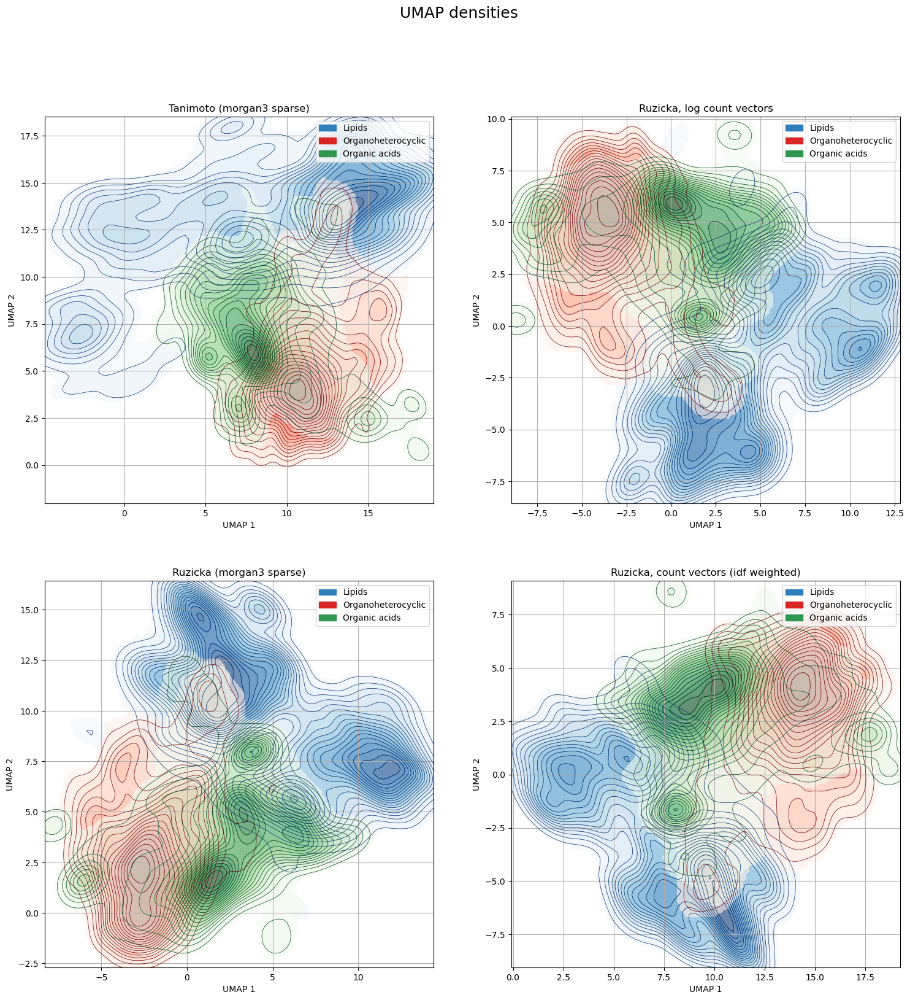

In [397]:
fig, axes = plt.subplots(2, 2, figsize=(18, 18))

mask_colormap_list = [
    ("Lipids", is_lipid, 'Blues'),
    ("Organoheterocyclic", is_organoheterocyclic, 'Reds'),
    ("Organic acids", is_acids, "Greens"),
]

# 1
x = umaps['umap_1_tanimoto_morgan3_sparse']
y = umaps['umap_2_tanimoto_morgan3_sparse']
density_plot(x, y, mask_colormap_list, axes[0, 0], title="Tanimoto (morgan3 sparse)")

# 2
x = umaps['umap_1_ruzicka_morgan3_sparse']
y = umaps['umap_2_ruzicka_morgan3_sparse']
density_plot(x, y, mask_colormap_list, axes[1, 0], title="Ruzicka (morgan3 sparse)")

# 3
x = umaps['umap_1_ruzicka_morgan3_log_count_sparse']
y = umaps['umap_2_ruzicka_morgan3_log_count_sparse']
density_plot(x, y, mask_colormap_list, axes[0, 1], title="Ruzicka, log count vectors")

# 4
x = umaps['umap_1_ruzicka_morgan3_tfidf_ms2structures_sparse']
y = umaps['umap_2_ruzicka_morgan3_tfidf_ms2structures_sparse']
density_plot(x, y, mask_colormap_list, axes[1, 1], title="Ruzicka, count vectors (idf weighted)")

fig.suptitle("UMAP densities", fontsize=18)
plt.savefig("UMAP_density_plots.pdf")
plt.show()

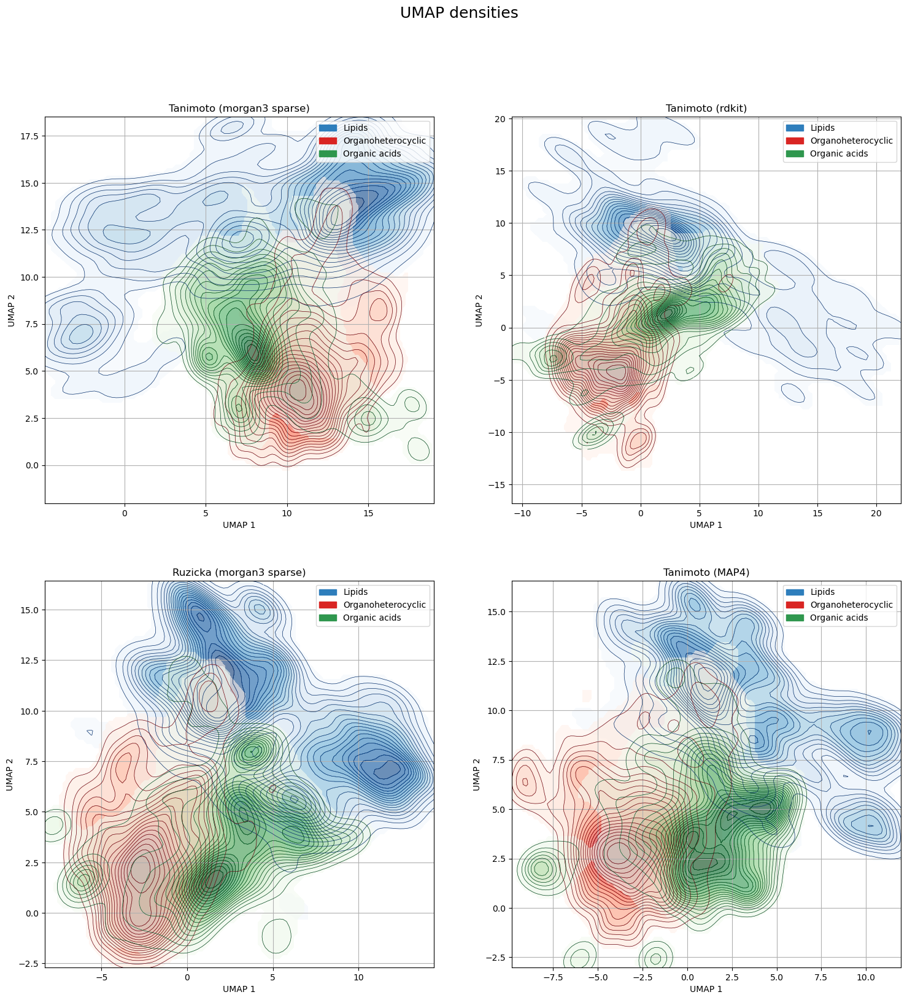

In [396]:
fig, axes = plt.subplots(2, 2, figsize=(18, 18))

mask_colormap_list = [
    ("Lipids", is_lipid, 'Blues'),
    ("Organoheterocyclic", is_organoheterocyclic, 'Reds'),
    ("Organic acids", is_acids, "Greens"),
]

# 1
x = umaps['umap_1_tanimoto_morgan3_sparse']
y = umaps['umap_2_tanimoto_morgan3_sparse']
density_plot(x, y, mask_colormap_list, axes[0, 0], title="Tanimoto (morgan3 sparse)")

# 2
x = umaps['umap_1_ruzicka_morgan3_sparse']
y = umaps['umap_2_ruzicka_morgan3_sparse']
density_plot(x, y, mask_colormap_list, axes[1, 0], title="Ruzicka (morgan3 sparse)")

# 3
x = umaps['umap_1_tanimoto_rdkit_sparse']
y = umaps['umap_2_tanimoto_rdkit_sparse']
density_plot(x, y, mask_colormap_list, axes[0, 1], title="Tanimoto (rdkit)")

# 4
x = umaps['umap_1_tanimoto_map4_sparse']
y = umaps['umap_2_tanimoto_map4_sparse']
density_plot(x, y, mask_colormap_list, axes[1, 1], title="Tanimoto (MAP4)")

fig.suptitle("UMAP densities", fontsize=18)
plt.savefig("UMAP_density_plots_morgan_rdkit_map4.pdf")
plt.show()

In [ ]:
"""
data_plot2 = compounds_updated.iloc[:, [0, 2, 4, 5, 6]].copy()
data_plot2["umap_1"] = umaps["umap_1_ruzicka_log"].values
data_plot2["umap_2"] = umaps["umap_2_ruzicka_log"].values
data_plot2 = data_plot2.fillna("unknown")
data_plot2["masses"] = compounds.mass

# generate a scatter plot
fig = px.scatter(data_plot2, x="umap_1", y="umap_2", width=2400, height=1600,
                 #size="masses",
                 color="cf_superclass",
                 #color="masses",
                )

# add molecules to the plotly graph - returns a Dash app
app = molplotly.add_molecules(
    fig=fig,
    df=data_plot2,
    smiles_col = 'smiles',
    title_col = 'inchikey',
    color_col = "cf_superclass",
    #size="masses",
    #color_col = "masses",
    )

app.run(port=8080, jupyter_mode="tab", jupyter_height=2000)
"""

Dash app running on http://127.0.0.1:8080/


/home/daisy/anaconda3/envs/ms2deepscore/lib/python3.10/site-packages/dash/dash.py:562: UserWarning:

JupyterDash is deprecated, use Dash instead.
See https://dash.plotly.com/dash-in-jupyter for more details.



<IPython.core.display.Javascript object>

In [ ]:
"""
data_plot2 = compounds_updated.iloc[:, [0, 2, 4, 5, 6]].copy()
data_plot2["umap_1"] = umaps["umap_1_ruzicka_log_weighted"].values
data_plot2["umap_2"] = umaps["umap_2_ruzicka_log_weighted"].values
data_plot2 = data_plot2.fillna("unknown")
data_plot2["masses"] = compounds.mass

# generate a scatter plot
fig = px.scatter(data_plot2, x="umap_1", y="umap_2", width=2400, height=1600,
                 #size="masses",
                 color="cf_superclass",
                 #color="masses",
                )

# add molecules to the plotly graph - returns a Dash app
app = molplotly.add_molecules(
    fig=fig,
    df=data_plot2,
    smiles_col = 'smiles',
    title_col = 'inchikey',
    color_col = "cf_superclass",
    #size="masses",
    #color_col = "masses",
    )

app.run(port=8081, jupyter_mode="tab", jupyter_height=2000)
"""

Dash app running on http://127.0.0.1:8081/


/home/daisy/anaconda3/envs/ms2deepscore/lib/python3.10/site-packages/dash/dash.py:562: UserWarning:

JupyterDash is deprecated, use Dash instead.
See https://dash.plotly.com/dash-in-jupyter for more details.



<IPython.core.display.Javascript object>